In [1]:
!pip install diffusers

   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 2.0/2.0 MB 21.1 MB/s eta 0:00:00


In [2]:
!pip install accelerate

## kandinsky-2-2-decoder

In [3]:
import torch
from diffusers import AutoPipelineForImage2Image
from diffusers.utils import load_image, make_image_grid

pipeline = AutoPipelineForImage2Image.from_pretrained(
    "kandinsky-community/kandinsky-2-2-decoder", torch_dtype=torch.float16, use_safetensors=True
)
pipeline.enable_model_cpu_offload()

The cache for model files in Transformers v4.22.0 has been updated. Migrating your old cache. This is a one-time only operation. You can interrupt this and resume the migration later on by calling `transformers.utils.move_cache()`.


0it [00:00, ?it/s]

2024-04-17 07:01:29.314396: E external/local_xla/xla/stream_executor/cuda/cuda_dnn.cc:9261] Unable to register cuDNN factory: Attempting to register factory for plugin cuDNN when one has already been registered
2024-04-17 07:01:29.314495: E external/local_xla/xla/stream_executor/cuda/cuda_fft.cc:607] Unable to register cuFFT factory: Attempting to register factory for plugin cuFFT when one has already been registered
2024-04-17 07:01:29.443321: E external/local_xla/xla/stream_executor/cuda/cuda_blas.cc:1515] Unable to register cuBLAS factory: Attempting to register factory for plugin cuBLAS when one has already been registered


model_index.json:   0%|          | 0.00/250 [00:00<?, ?B/s]

Fetching 7 files:   0%|          | 0/7 [00:00<?, ?it/s]

unet/config.json:   0%|          | 0.00/1.67k [00:00<?, ?B/s]

movq/config.json:   0%|          | 0.00/660 [00:00<?, ?B/s]

scheduler/scheduler_config.json:   0%|          | 0.00/317 [00:00<?, ?B/s]

README.md:   0%|          | 0.00/7.34k [00:00<?, ?B/s]

unet/diffusion_pytorch_model.safetensors:   0%|          | 0.00/5.01G [00:00<?, ?B/s]

movq/diffusion_pytorch_model.safetensors:   0%|          | 0.00/271M [00:00<?, ?B/s]

Loading pipeline components...:   0%|          | 0/3 [00:00<?, ?it/s]

model_index.json:   0%|          | 0.00/501 [00:00<?, ?B/s]

Fetching 13 files:   0%|          | 0/13 [00:00<?, ?it/s]

prior/config.json:   0%|          | 0.00/252 [00:00<?, ?B/s]

image_encoder/config.json:   0%|          | 0.00/2.01k [00:00<?, ?B/s]

text_encoder/config.json:   0%|          | 0.00/2.02k [00:00<?, ?B/s]

image_encoder/model.safetensors:   0%|          | 0.00/3.69G [00:00<?, ?B/s]

scheduler/scheduler_config.json:   0%|          | 0.00/229 [00:00<?, ?B/s]

image_processor/preprocessor_config.json:   0%|          | 0.00/315 [00:00<?, ?B/s]

text_encoder/model.safetensors:   0%|          | 0.00/2.78G [00:00<?, ?B/s]

(…)rior/diffusion_pytorch_model.safetensors:   0%|          | 0.00/4.10G [00:00<?, ?B/s]

tokenizer/merges.txt:   0%|          | 0.00/525k [00:00<?, ?B/s]

tokenizer/special_tokens_map.json:   0%|          | 0.00/389 [00:00<?, ?B/s]

tokenizer/tokenizer_config.json:   0%|          | 0.00/904 [00:00<?, ?B/s]

tokenizer/vocab.json:   0%|          | 0.00/862k [00:00<?, ?B/s]

Loading pipeline components...:   0%|          | 0/6 [00:00<?, ?it/s]

/tmp/ipykernel_25/2345811828.py:12: DeprecationWarning: ANTIALIAS is deprecated and will be removed in Pillow 10 (2023-07-01). Use LANCZOS or Resampling.LANCZOS instead.
  init_image = image.resize(new_size, Image.ANTIALIAS)


  0%|          | 0/25 [00:00<?, ?it/s]

/opt/conda/lib/python3.10/site-packages/diffusers/pipelines/kandinsky2_2/pipeline_kandinsky2_2_img2img.py:276: FutureWarning: `callback_steps` is deprecated and will be removed in version 1.0.0. Passing `callback_steps` as an input argument to `__call__` is deprecated, consider use `callback_on_step_end`
  deprecate(


  0%|          | 0/30 [00:00<?, ?it/s]

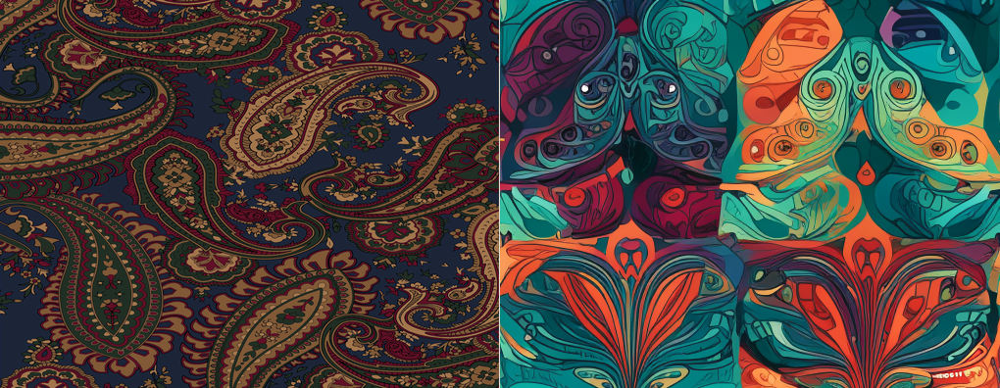

In [4]:
from PIL import Image
import io

image_path = "/kaggle/input/images/PRINT PAGE-CU8439.jpg"# Update this path

image = Image.open(image_path)

# Specify the new size. For example, to resize to half the original width and height
new_size = (image.width // 6, image.height // 10)

# Resize the image
init_image = image.resize(new_size, Image.ANTIALIAS)

prompt = "Create a new variation of the provided design pattern, capturing the original's artistic style and color scheme. Adapt the design to include new, yet harmonious color combinations, ensuring variant respects the initial pattern's essence and artistic flair. Aim for diversity while maintaining a cohesive link to the original concept."

image = pipeline(prompt, image=init_image).images[0]
make_image_grid([init_image, image], rows=1, cols=2)

/tmp/ipykernel_25/2738597824.py:9: DeprecationWarning: ANTIALIAS is deprecated and will be removed in Pillow 10 (2023-07-01). Use LANCZOS or Resampling.LANCZOS instead.
  init_image = image.resize(new_size, Image.ANTIALIAS)


  0%|          | 0/25 [00:00<?, ?it/s]

  0%|          | 0/30 [00:00<?, ?it/s]

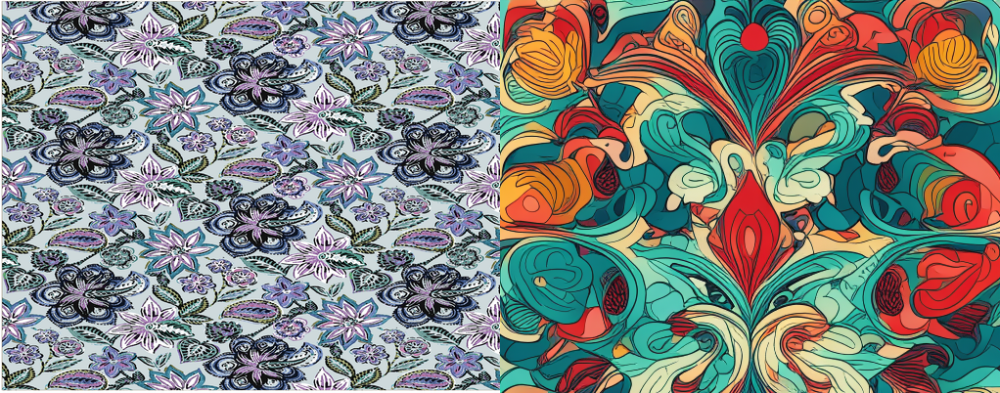

In [5]:
image_path = "/kaggle/input/images/281.jpg"# Update this path

image = Image.open(image_path)

# Specify the new size. For example, to resize to half the original width and height
new_size = (image.width // 6, image.height // 10)

# Resize the image
init_image = image.resize(new_size, Image.ANTIALIAS)

prompt = "Create new variation of the provided design pattern, capturing the original's artistic style and color scheme. Adapt the design to include new, yet harmonious color combinations, ensuring variant respects the initial pattern's essence and artistic flair. Aim for diversity while maintaining a cohesive link to the original concept."

image = pipeline(prompt, image=init_image).images[0]
make_image_grid([init_image, image], rows=1, cols=2)

/tmp/ipykernel_25/3416831915.py:9: DeprecationWarning: ANTIALIAS is deprecated and will be removed in Pillow 10 (2023-07-01). Use LANCZOS or Resampling.LANCZOS instead.
  init_image = image.resize(new_size, Image.ANTIALIAS)


  0%|          | 0/25 [00:00<?, ?it/s]

  0%|          | 0/30 [00:00<?, ?it/s]

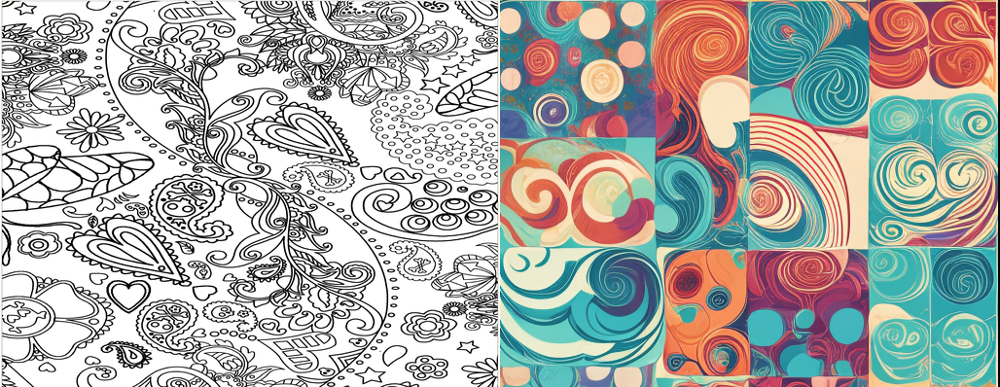

In [6]:
image_path = "/kaggle/input/images/80403031-PP.jpg"# Update this path

image = Image.open(image_path)

# Specify the new size. For example, to resize to half the original width and height
new_size = (image.width // 6, image.height // 10)

# Resize the image
init_image = image.resize(new_size, Image.ANTIALIAS)

prompt = "Create new variation of the provided design pattern, capturing the original's artistic style and color scheme. Adapt the design to include new, yet harmonious color combinations, ensuring variant respects the initial pattern's essence and artistic flair. Aim for diversity while maintaining a cohesive link to the original concept."

image = pipeline(prompt, image=init_image).images[0]
make_image_grid([init_image, image], rows=1, cols=2)

/tmp/ipykernel_25/247002066.py:9: DeprecationWarning: ANTIALIAS is deprecated and will be removed in Pillow 10 (2023-07-01). Use LANCZOS or Resampling.LANCZOS instead.
  init_image = image.resize(new_size, Image.ANTIALIAS)


  0%|          | 0/25 [00:00<?, ?it/s]

  0%|          | 0/30 [00:00<?, ?it/s]

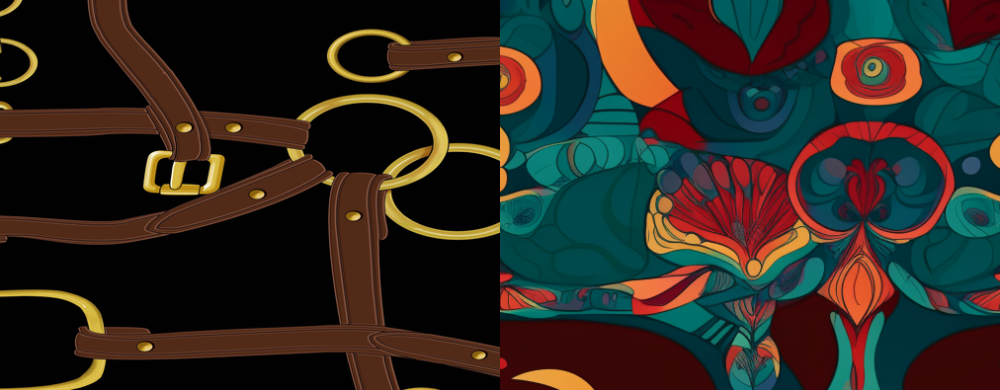

In [7]:
image_path = "/kaggle/input/images/PRINT PAGE-CU8710.jpg"# Update this path

image = Image.open(image_path)

# Specify the new size. For example, to resize to half the original width and height
new_size = (image.width // 6, image.height // 10)

# Resize the image
init_image = image.resize(new_size, Image.ANTIALIAS)

prompt = "Create a new variation of the provided design pattern, capturing the original's artistic style and color scheme. Adapt the design to include new, yet harmonious color combinations, ensuring variant respects the initial pattern's essence and artistic flair. Aim for diversity while maintaining a cohesive link to the original concept."

image = pipeline(prompt, image=init_image).images[0]
make_image_grid([init_image, image], rows=1, cols=2)

/tmp/ipykernel_25/124479014.py:9: DeprecationWarning: ANTIALIAS is deprecated and will be removed in Pillow 10 (2023-07-01). Use LANCZOS or Resampling.LANCZOS instead.
  init_image = image.resize(new_size, Image.ANTIALIAS)


  0%|          | 0/25 [00:00<?, ?it/s]

  0%|          | 0/30 [00:00<?, ?it/s]

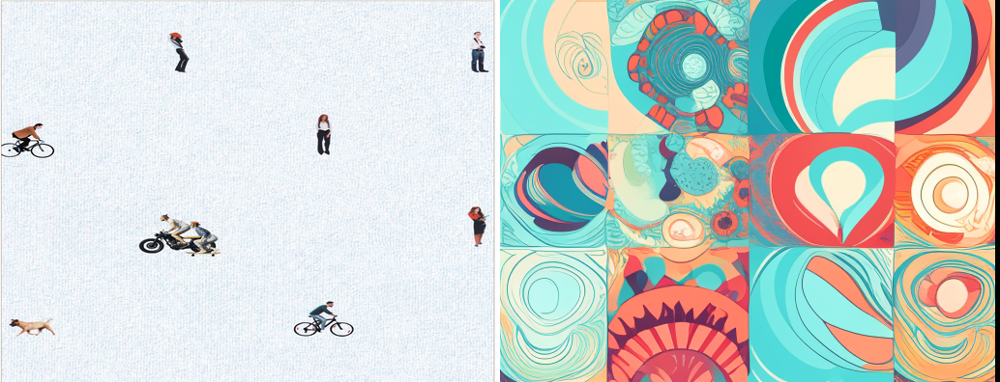

In [8]:
image_path = "/kaggle/input/images/PRINT PAGE-NC2406.jpg"# Update this path

image = Image.open(image_path)

# Specify the new size. For example, to resize to half the original width and height
new_size = (image.width // 6, image.height // 10)

# Resize the image
init_image = image.resize(new_size, Image.ANTIALIAS)

prompt = "Create a new variation of the provided design pattern, capturing the original's artistic style and color scheme. Adapt the design to include new, yet harmonious color combinations, ensuring variant respects the initial pattern's essence and artistic flair. Aim for diversity while maintaining a cohesive link to the original concept."

image = pipeline(prompt, image=init_image).images[0]
make_image_grid([init_image, image], rows=1, cols=2)

## Stable Diffusion v1.5   (runwayml/stable-diffusion-v1-5)

In [9]:
import torch
from diffusers import AutoPipelineForImage2Image
from diffusers.utils import make_image_grid, load_image

pipeline = AutoPipelineForImage2Image.from_pretrained(
    "runwayml/stable-diffusion-v1-5", torch_dtype=torch.float16, variant="fp16", use_safetensors=True
)
pipeline.enable_model_cpu_offload()

model_index.json:   0%|          | 0.00/541 [00:00<?, ?B/s]

Fetching 15 files:   0%|          | 0/15 [00:00<?, ?it/s]

(…)ature_extractor/preprocessor_config.json:   0%|          | 0.00/342 [00:00<?, ?B/s]

safety_checker/config.json:   0%|          | 0.00/4.72k [00:00<?, ?B/s]

text_encoder/config.json:   0%|          | 0.00/617 [00:00<?, ?B/s]

tokenizer/merges.txt:   0%|          | 0.00/525k [00:00<?, ?B/s]

tokenizer/special_tokens_map.json:   0%|          | 0.00/472 [00:00<?, ?B/s]

scheduler/scheduler_config.json:   0%|          | 0.00/308 [00:00<?, ?B/s]

safety_checker/model.fp16.safetensors:   0%|          | 0.00/608M [00:00<?, ?B/s]

text_encoder/model.fp16.safetensors:   0%|          | 0.00/246M [00:00<?, ?B/s]

tokenizer/vocab.json:   0%|          | 0.00/1.06M [00:00<?, ?B/s]

unet/config.json:   0%|          | 0.00/743 [00:00<?, ?B/s]

tokenizer/tokenizer_config.json:   0%|          | 0.00/806 [00:00<?, ?B/s]

vae/config.json:   0%|          | 0.00/547 [00:00<?, ?B/s]

(…)diffusion_pytorch_model.fp16.safetensors:   0%|          | 0.00/1.72G [00:00<?, ?B/s]

(…)diffusion_pytorch_model.fp16.safetensors:   0%|          | 0.00/167M [00:00<?, ?B/s]

Loading pipeline components...:   0%|          | 0/7 [00:00<?, ?it/s]

/tmp/ipykernel_25/2345811828.py:12: DeprecationWarning: ANTIALIAS is deprecated and will be removed in Pillow 10 (2023-07-01). Use LANCZOS or Resampling.LANCZOS instead.
  init_image = image.resize(new_size, Image.ANTIALIAS)


  0%|          | 0/40 [00:00<?, ?it/s]

Potential NSFW content was detected in one or more images. A black image will be returned instead. Try again with a different prompt and/or seed.


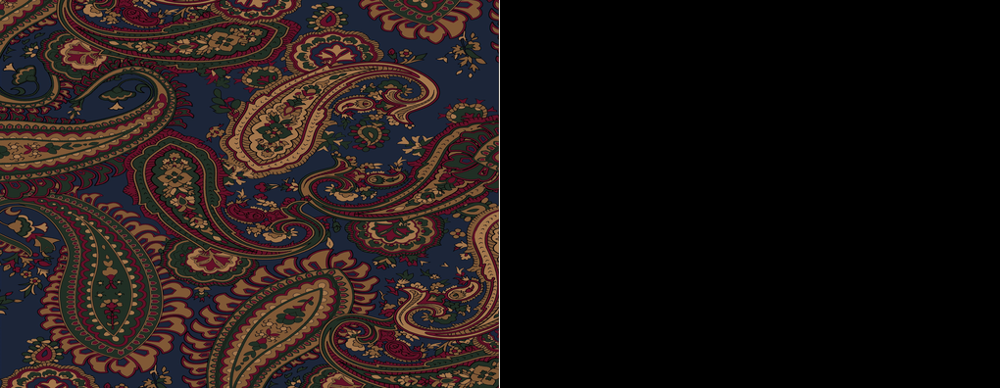

In [10]:
from PIL import Image
import io

image_path = "/kaggle/input/images/PRINT PAGE-CU8439.jpg"# Update this path

image = Image.open(image_path)

# Specify the new size. For example, to resize to half the original width and height
new_size = (image.width // 6, image.height // 10)

# Resize the image
init_image = image.resize(new_size, Image.ANTIALIAS)

prompt = "Create a new variation of the provided design pattern, capturing the original's artistic style and color scheme. Adapt the design to include new, yet harmonious color combinations, ensuring variant respects the initial pattern's essence and artistic flair. Aim for diversity while maintaining a cohesive link to the original concept."

image = pipeline(prompt, image=init_image).images[0]
make_image_grid([init_image, image], rows=1, cols=2)

/tmp/ipykernel_25/2738597824.py:9: DeprecationWarning: ANTIALIAS is deprecated and will be removed in Pillow 10 (2023-07-01). Use LANCZOS or Resampling.LANCZOS instead.
  init_image = image.resize(new_size, Image.ANTIALIAS)


  0%|          | 0/40 [00:00<?, ?it/s]

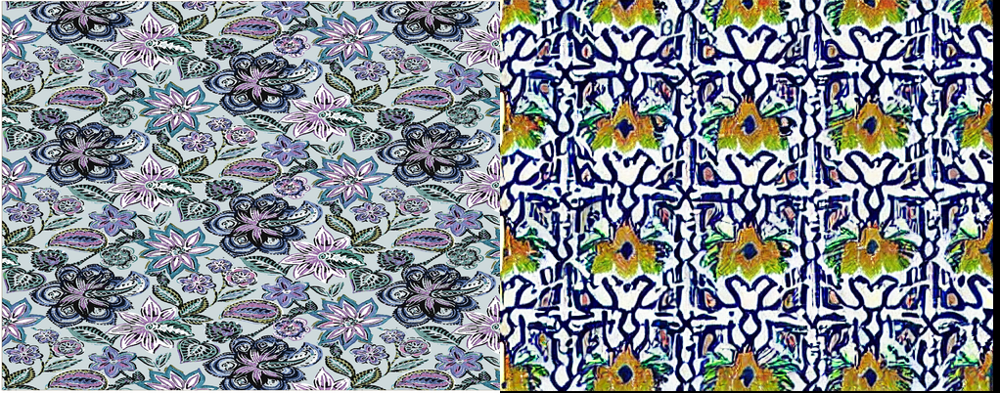

In [11]:
image_path = "/kaggle/input/images/281.jpg"# Update this path

image = Image.open(image_path)

# Specify the new size. For example, to resize to half the original width and height
new_size = (image.width // 6, image.height // 10)

# Resize the image
init_image = image.resize(new_size, Image.ANTIALIAS)

prompt = "Create new variation of the provided design pattern, capturing the original's artistic style and color scheme. Adapt the design to include new, yet harmonious color combinations, ensuring variant respects the initial pattern's essence and artistic flair. Aim for diversity while maintaining a cohesive link to the original concept."

image = pipeline(prompt, image=init_image).images[0]
make_image_grid([init_image, image], rows=1, cols=2)

/tmp/ipykernel_25/3416831915.py:9: DeprecationWarning: ANTIALIAS is deprecated and will be removed in Pillow 10 (2023-07-01). Use LANCZOS or Resampling.LANCZOS instead.
  init_image = image.resize(new_size, Image.ANTIALIAS)


  0%|          | 0/40 [00:00<?, ?it/s]

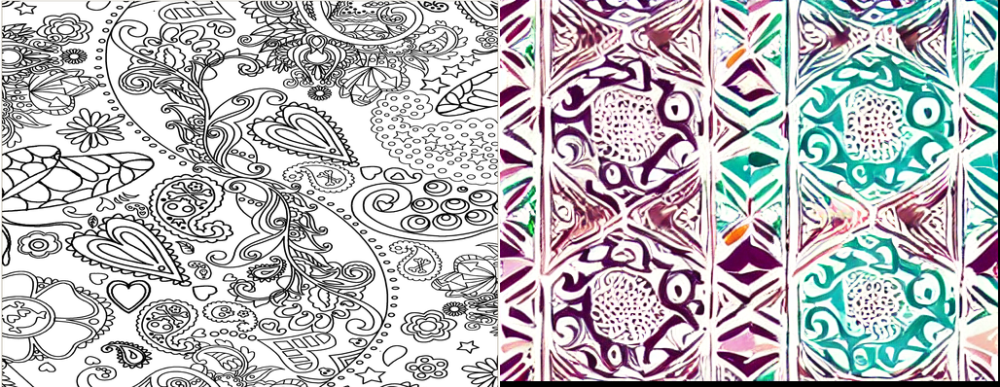

In [12]:
image_path = "/kaggle/input/images/80403031-PP.jpg"# Update this path

image = Image.open(image_path)

# Specify the new size. For example, to resize to half the original width and height
new_size = (image.width // 6, image.height // 10)

# Resize the image
init_image = image.resize(new_size, Image.ANTIALIAS)

prompt = "Create new variation of the provided design pattern, capturing the original's artistic style and color scheme. Adapt the design to include new, yet harmonious color combinations, ensuring variant respects the initial pattern's essence and artistic flair. Aim for diversity while maintaining a cohesive link to the original concept."

image = pipeline(prompt, image=init_image).images[0]
make_image_grid([init_image, image], rows=1, cols=2)

/tmp/ipykernel_25/247002066.py:9: DeprecationWarning: ANTIALIAS is deprecated and will be removed in Pillow 10 (2023-07-01). Use LANCZOS or Resampling.LANCZOS instead.
  init_image = image.resize(new_size, Image.ANTIALIAS)


  0%|          | 0/40 [00:00<?, ?it/s]

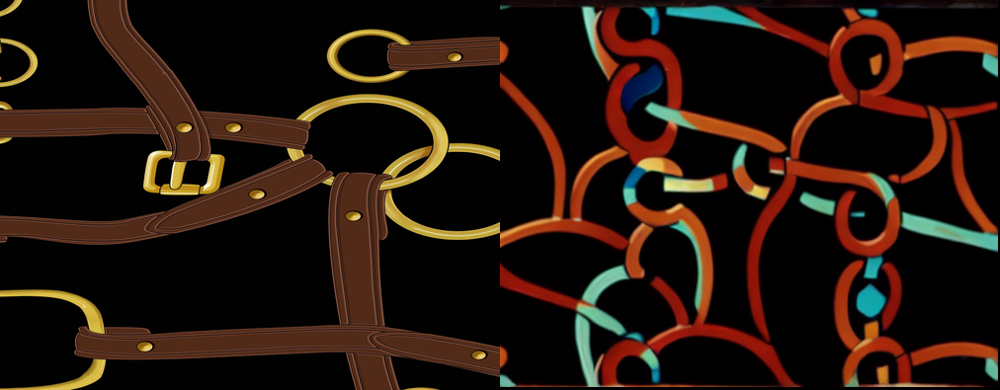

In [13]:
image_path = "/kaggle/input/images/PRINT PAGE-CU8710.jpg"# Update this path

image = Image.open(image_path)

# Specify the new size. For example, to resize to half the original width and height
new_size = (image.width // 6, image.height // 10)

# Resize the image
init_image = image.resize(new_size, Image.ANTIALIAS)

prompt = "Create a new variation of the provided design pattern, capturing the original's artistic style and color scheme. Adapt the design to include new, yet harmonious color combinations, ensuring variant respects the initial pattern's essence and artistic flair. Aim for diversity while maintaining a cohesive link to the original concept."

image = pipeline(prompt, image=init_image).images[0]
make_image_grid([init_image, image], rows=1, cols=2)

/tmp/ipykernel_25/124479014.py:9: DeprecationWarning: ANTIALIAS is deprecated and will be removed in Pillow 10 (2023-07-01). Use LANCZOS or Resampling.LANCZOS instead.
  init_image = image.resize(new_size, Image.ANTIALIAS)


  0%|          | 0/40 [00:00<?, ?it/s]

Potential NSFW content was detected in one or more images. A black image will be returned instead. Try again with a different prompt and/or seed.


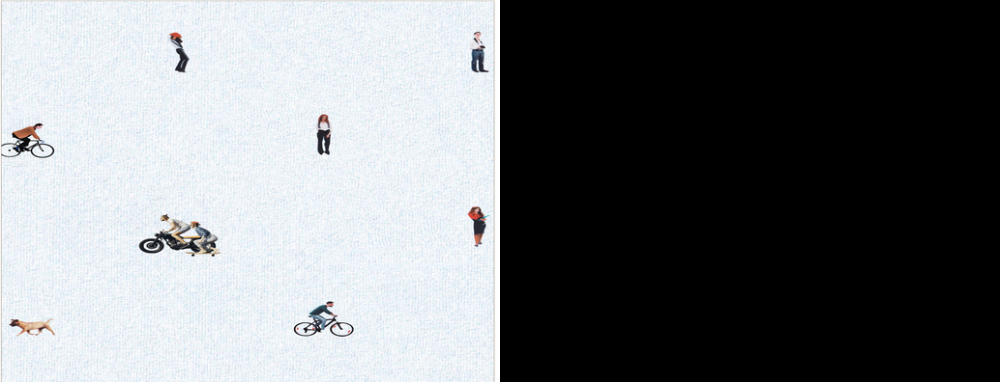

In [14]:
image_path = "/kaggle/input/images/PRINT PAGE-NC2406.jpg"# Update this path

image = Image.open(image_path)

# Specify the new size. For example, to resize to half the original width and height
new_size = (image.width // 6, image.height // 10)

# Resize the image
init_image = image.resize(new_size, Image.ANTIALIAS)

prompt = "Create a new variation of the provided design pattern, capturing the original's artistic style and color scheme. Adapt the design to include new, yet harmonious color combinations, ensuring variant respects the initial pattern's essence and artistic flair. Aim for diversity while maintaining a cohesive link to the original concept."

image = pipeline(prompt, image=init_image).images[0]
make_image_grid([init_image, image], rows=1, cols=2)

## Stable Diffusion XL (SDXL)  (stabilityai/stable-diffusion-xl-refiner-1.0)

In [15]:
import torch
from diffusers import AutoPipelineForImage2Image
from diffusers.utils import make_image_grid, load_image

pipeline = AutoPipelineForImage2Image.from_pretrained(
    "stabilityai/stable-diffusion-xl-refiner-1.0", torch_dtype=torch.float16, variant="fp16", use_safetensors=True
)
pipeline.enable_model_cpu_offload()

model_index.json:   0%|          | 0.00/612 [00:00<?, ?B/s]

Fetching 13 files:   0%|          | 0/13 [00:00<?, ?it/s]

text_encoder_2/model.fp16.safetensors:   0%|          | 0.00/1.39G [00:00<?, ?B/s]

scheduler/scheduler_config.json:   0%|          | 0.00/479 [00:00<?, ?B/s]

text_encoder_2/config.json:   0%|          | 0.00/575 [00:00<?, ?B/s]

unet/config.json:   0%|          | 0.00/1.71k [00:00<?, ?B/s]

tokenizer_2/merges.txt:   0%|          | 0.00/525k [00:00<?, ?B/s]

tokenizer_2/tokenizer_config.json:   0%|          | 0.00/725 [00:00<?, ?B/s]

tokenizer_2/special_tokens_map.json:   0%|          | 0.00/460 [00:00<?, ?B/s]

tokenizer_2/vocab.json:   0%|          | 0.00/1.06M [00:00<?, ?B/s]

(…)diffusion_pytorch_model.fp16.safetensors:   0%|          | 0.00/4.52G [00:00<?, ?B/s]

vae/config.json:   0%|          | 0.00/642 [00:00<?, ?B/s]

(…)diffusion_pytorch_model.fp16.safetensors:   0%|          | 0.00/167M [00:00<?, ?B/s]

(…)diffusion_pytorch_model.fp16.safetensors:   0%|          | 0.00/167M [00:00<?, ?B/s]

Loading pipeline components...:   0%|          | 0/5 [00:00<?, ?it/s]

/tmp/ipykernel_25/367366736.py:9: DeprecationWarning: ANTIALIAS is deprecated and will be removed in Pillow 10 (2023-07-01). Use LANCZOS or Resampling.LANCZOS instead.
  init_image = image.resize(new_size, Image.ANTIALIAS)


  0%|          | 0/15 [00:00<?, ?it/s]

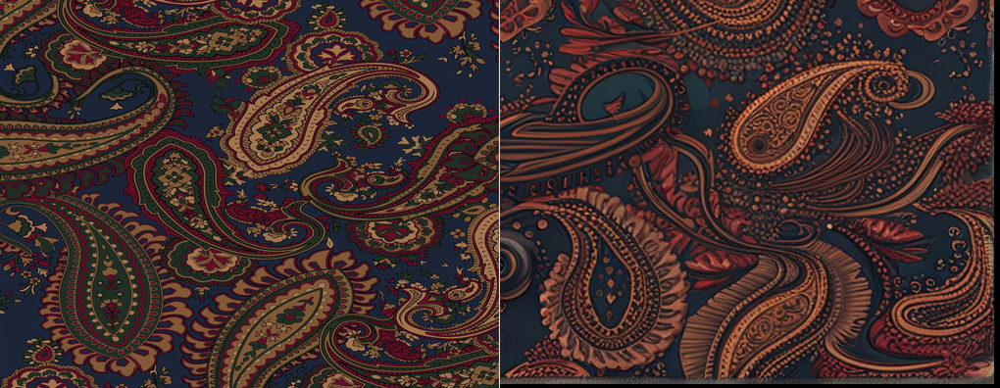

In [16]:
image_path = "/kaggle/input/images/PRINT PAGE-CU8439.jpg"# Update this path

image = Image.open(image_path)

# Specify the new size. For example, to resize to half the original width and height
new_size = (image.width // 6, image.height // 10)

# Resize the image
init_image = image.resize(new_size, Image.ANTIALIAS)

prompt = "Create a new variation of the provided design pattern, capturing the original's artistic style and color scheme. Adapt the design to include new, yet harmonious color combinations, ensuring variant respects the initial pattern's essence and artistic flair. Aim for diversity while maintaining a cohesive link to the original concept."

image = pipeline(prompt, image=init_image).images[0]
make_image_grid([init_image, image], rows=1, cols=2)

/tmp/ipykernel_25/2738597824.py:9: DeprecationWarning: ANTIALIAS is deprecated and will be removed in Pillow 10 (2023-07-01). Use LANCZOS or Resampling.LANCZOS instead.
  init_image = image.resize(new_size, Image.ANTIALIAS)


  0%|          | 0/15 [00:00<?, ?it/s]

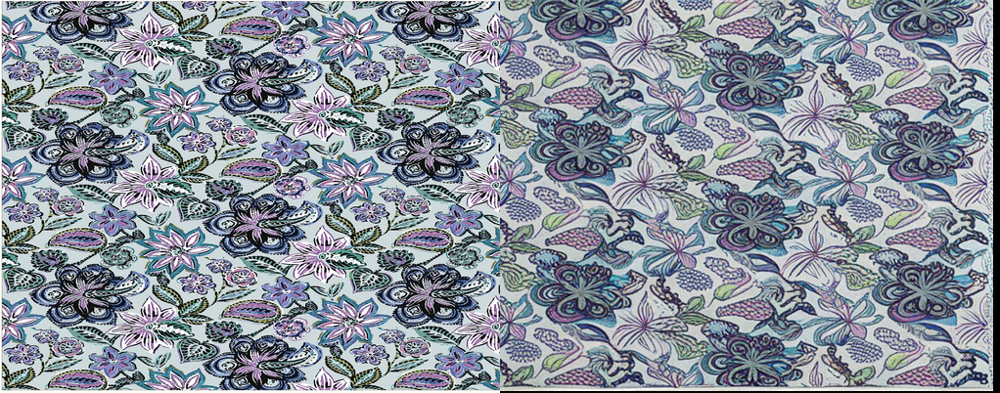

In [17]:
image_path = "/kaggle/input/images/281.jpg"# Update this path

image = Image.open(image_path)

# Specify the new size. For example, to resize to half the original width and height
new_size = (image.width // 6, image.height // 10)

# Resize the image
init_image = image.resize(new_size, Image.ANTIALIAS)

prompt = "Create new variation of the provided design pattern, capturing the original's artistic style and color scheme. Adapt the design to include new, yet harmonious color combinations, ensuring variant respects the initial pattern's essence and artistic flair. Aim for diversity while maintaining a cohesive link to the original concept."

image = pipeline(prompt, image=init_image).images[0]
make_image_grid([init_image, image], rows=1, cols=2)

/tmp/ipykernel_25/3416831915.py:9: DeprecationWarning: ANTIALIAS is deprecated and will be removed in Pillow 10 (2023-07-01). Use LANCZOS or Resampling.LANCZOS instead.
  init_image = image.resize(new_size, Image.ANTIALIAS)


  0%|          | 0/15 [00:00<?, ?it/s]

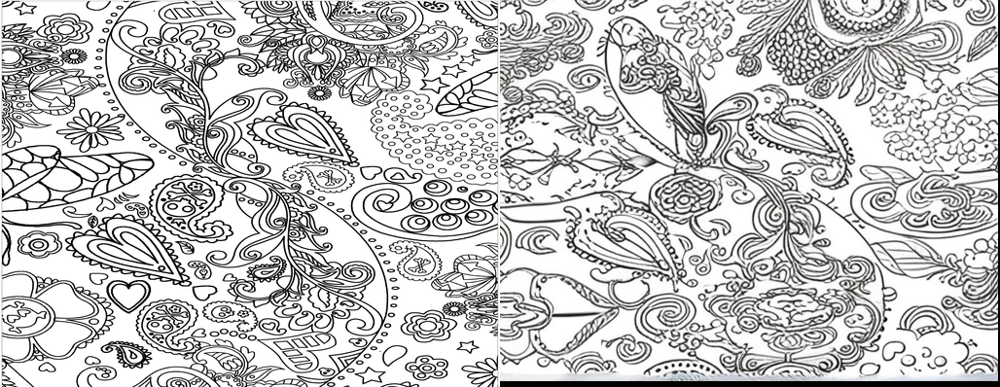

In [18]:
image_path = "/kaggle/input/images/80403031-PP.jpg"# Update this path

image = Image.open(image_path)

# Specify the new size. For example, to resize to half the original width and height
new_size = (image.width // 6, image.height // 10)

# Resize the image
init_image = image.resize(new_size, Image.ANTIALIAS)

prompt = "Create new variation of the provided design pattern, capturing the original's artistic style and color scheme. Adapt the design to include new, yet harmonious color combinations, ensuring variant respects the initial pattern's essence and artistic flair. Aim for diversity while maintaining a cohesive link to the original concept."

image = pipeline(prompt, image=init_image).images[0]
make_image_grid([init_image, image], rows=1, cols=2)

/tmp/ipykernel_25/1840984117.py:9: DeprecationWarning: ANTIALIAS is deprecated and will be removed in Pillow 10 (2023-07-01). Use LANCZOS or Resampling.LANCZOS instead.
  init_image = image.resize(new_size, Image.ANTIALIAS)


  0%|          | 0/20 [00:00<?, ?it/s]

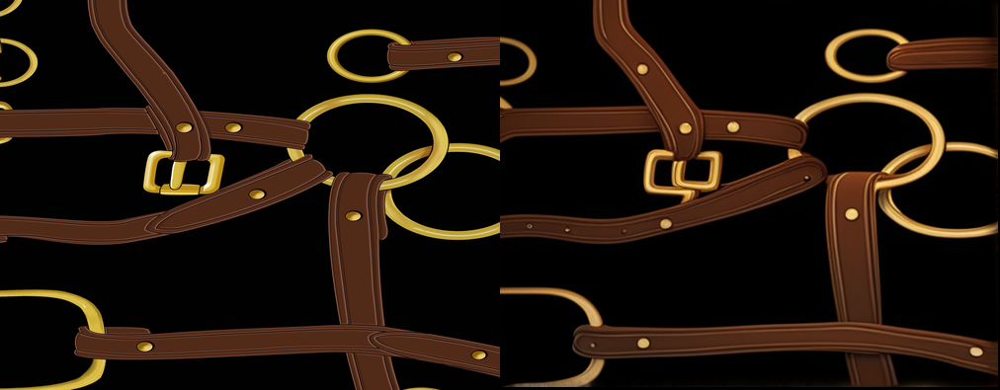

In [19]:
image_path = "/kaggle/input/images/PRINT PAGE-CU8710.jpg"# Update this path

image = Image.open(image_path)

# Specify the new size. For example, to resize to half the original width and height
new_size = (image.width // 6, image.height // 10)

# Resize the image
init_image = image.resize(new_size, Image.ANTIALIAS)

prompt = "Create a new variation of the provided design pattern, capturing the original's artistic style and color scheme. Adapt the design to include new, yet harmonious color combinations, ensuring variant respects the initial pattern's essence and artistic flair. Aim for diversity while maintaining a cohesive link to the original concept."

image = pipeline(prompt, image=init_image,strength=0.4).images[0]
make_image_grid([init_image, image], rows=1, cols=2)

/tmp/ipykernel_25/1436019392.py:9: DeprecationWarning: ANTIALIAS is deprecated and will be removed in Pillow 10 (2023-07-01). Use LANCZOS or Resampling.LANCZOS instead.
  init_image = image.resize(new_size, Image.ANTIALIAS)


  0%|          | 0/27 [00:00<?, ?it/s]

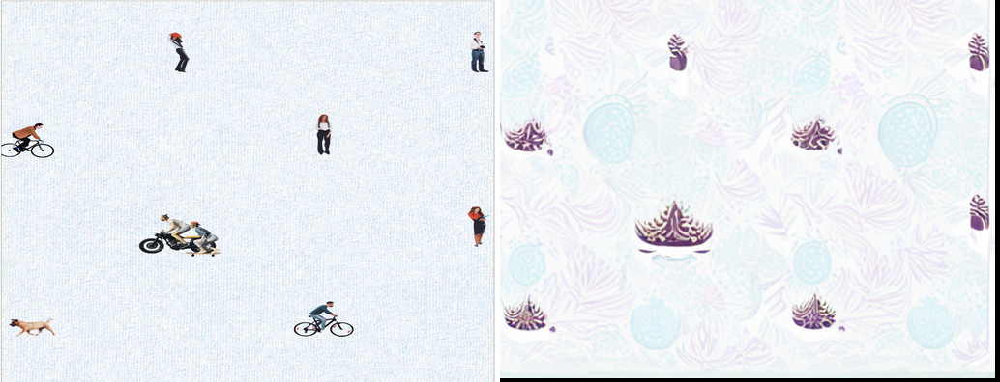

In [20]:
image_path = "/kaggle/input/images/PRINT PAGE-NC2406.jpg"# Update this path

image = Image.open(image_path)

# Specify the new size. For example, to resize to half the original width and height
new_size = (image.width // 6, image.height // 10)

# Resize the image
init_image = image.resize(new_size, Image.ANTIALIAS)

prompt = "Create a new variation of the provided design pattern, capturing the original's artistic style and color scheme. Adapt the design to include new, yet harmonious color combinations, ensuring variant respects the initial pattern's essence and artistic flair. Aim for diversity while maintaining a cohesive link to the original concept."

image = pipeline(prompt, image=init_image,strength=0.55).images[0]
make_image_grid([init_image, image], rows=1, cols=2)

## Stable Diffusion XL Turbo

In [21]:
from diffusers import AutoPipelineForText2Image
import torch

pipeline_text2image = AutoPipelineForText2Image.from_pretrained("stabilityai/sdxl-turbo", torch_dtype=torch.float16, variant="fp16")
pipeline_text2image = pipeline_text2image.to("cuda")

model_index.json:   0%|          | 0.00/685 [00:00<?, ?B/s]

Fetching 18 files:   0%|          | 0/18 [00:00<?, ?it/s]

tokenizer/special_tokens_map.json:   0%|          | 0.00/586 [00:00<?, ?B/s]

tokenizer/tokenizer_config.json:   0%|          | 0.00/704 [00:00<?, ?B/s]

text_encoder/config.json:   0%|          | 0.00/565 [00:00<?, ?B/s]

scheduler/scheduler_config.json:   0%|          | 0.00/459 [00:00<?, ?B/s]

text_encoder/model.fp16.safetensors:   0%|          | 0.00/246M [00:00<?, ?B/s]

tokenizer/merges.txt:   0%|          | 0.00/525k [00:00<?, ?B/s]

text_encoder_2/config.json:   0%|          | 0.00/575 [00:00<?, ?B/s]

text_encoder_2/model.fp16.safetensors:   0%|          | 0.00/1.39G [00:00<?, ?B/s]

tokenizer/vocab.json:   0%|          | 0.00/1.06M [00:00<?, ?B/s]

tokenizer_2/tokenizer_config.json:   0%|          | 0.00/855 [00:00<?, ?B/s]

unet/config.json:   0%|          | 0.00/1.78k [00:00<?, ?B/s]

tokenizer_2/special_tokens_map.json:   0%|          | 0.00/460 [00:00<?, ?B/s]

(…)diffusion_pytorch_model.fp16.safetensors:   0%|          | 0.00/5.14G [00:00<?, ?B/s]

tokenizer_2/vocab.json:   0%|          | 0.00/1.06M [00:00<?, ?B/s]

vae/config.json:   0%|          | 0.00/607 [00:00<?, ?B/s]

(…)diffusion_pytorch_model.fp16.safetensors:   0%|          | 0.00/167M [00:00<?, ?B/s]

Loading pipeline components...:   0%|          | 0/7 [00:00<?, ?it/s]

In [22]:
from diffusers import AutoPipelineForImage2Image
from diffusers.utils import load_image, make_image_grid

# use from_pipe to avoid consuming additional memory when loading a checkpoint
pipeline_image2image = AutoPipelineForImage2Image.from_pipe(pipeline_text2image).to("cuda")

/tmp/ipykernel_25/717134118.py:12: DeprecationWarning: ANTIALIAS is deprecated and will be removed in Pillow 10 (2023-07-01). Use LANCZOS or Resampling.LANCZOS instead.
  init_image = image.resize(new_size, Image.ANTIALIAS)


  0%|          | 0/25 [00:00<?, ?it/s]

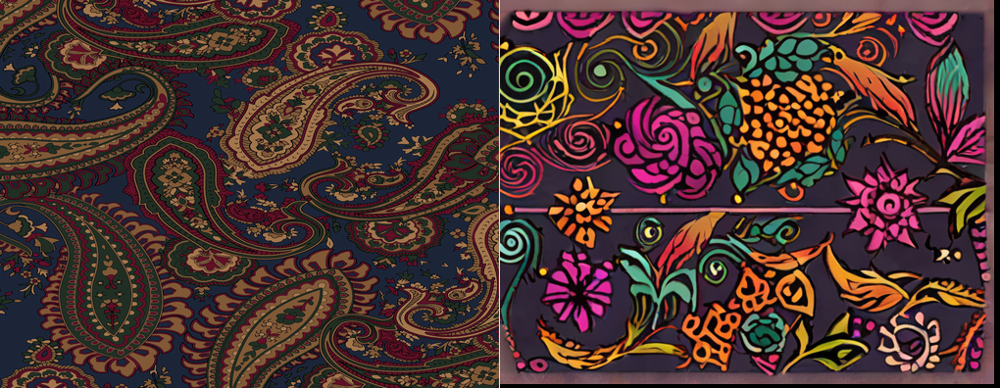

In [23]:
from PIL import Image
import io

image_path = "/kaggle/input/images/PRINT PAGE-CU8439.jpg"# Update this path

image = Image.open(image_path)

# Specify the new size. For example, to resize to half the original width and height
new_size = (image.width // 6, image.height // 10)

# Resize the image
init_image = image.resize(new_size, Image.ANTIALIAS)

prompt = "Create a new variation of the provided design pattern, capturing the original's artistic style and color scheme. Adapt the design to include new, yet harmonious color combinations, ensuring variant respects the initial pattern's essence and artistic flair. Aim for diversity while maintaining a cohesive link to the original concept."

image = pipeline_image2image(prompt, image=init_image,strength=0.5, guidance_scale=0.0, num_inference_steps=50).images[0]
make_image_grid([init_image, image], rows=1, cols=2)

/tmp/ipykernel_25/731482782.py:9: DeprecationWarning: ANTIALIAS is deprecated and will be removed in Pillow 10 (2023-07-01). Use LANCZOS or Resampling.LANCZOS instead.
  init_image = image.resize(new_size, Image.ANTIALIAS)


  0%|          | 0/10 [00:00<?, ?it/s]

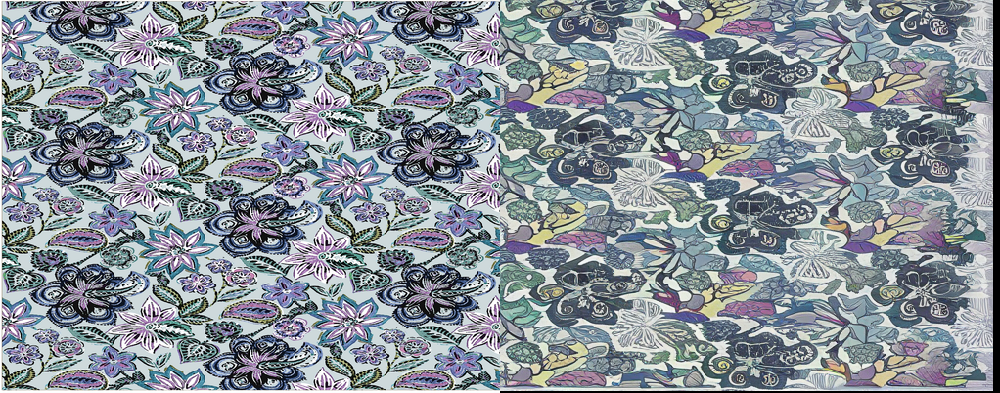

In [24]:
image_path = "/kaggle/input/images/281.jpg"# Update this path

image = Image.open(image_path)

# Specify the new size. For example, to resize to half the original width and height
new_size = (image.width // 6, image.height // 10)

# Resize the image
init_image = image.resize(new_size, Image.ANTIALIAS)

prompt = "Create a new variation of the provided design pattern, capturing the original's artistic style and color scheme. Adapt the design to include new, yet harmonious color combinations, ensuring variant respects the initial pattern's essence and artistic flair. Aim for diversity while maintaining a cohesive link to the original concept."

image = pipeline_image2image(prompt, image=init_image, strength=0.2).images[0]
make_image_grid([init_image, image], rows=1, cols=2)

/tmp/ipykernel_25/1792030975.py:9: DeprecationWarning: ANTIALIAS is deprecated and will be removed in Pillow 10 (2023-07-01). Use LANCZOS or Resampling.LANCZOS instead.
  init_image = image.resize(new_size, Image.ANTIALIAS)


  0%|          | 0/30 [00:00<?, ?it/s]

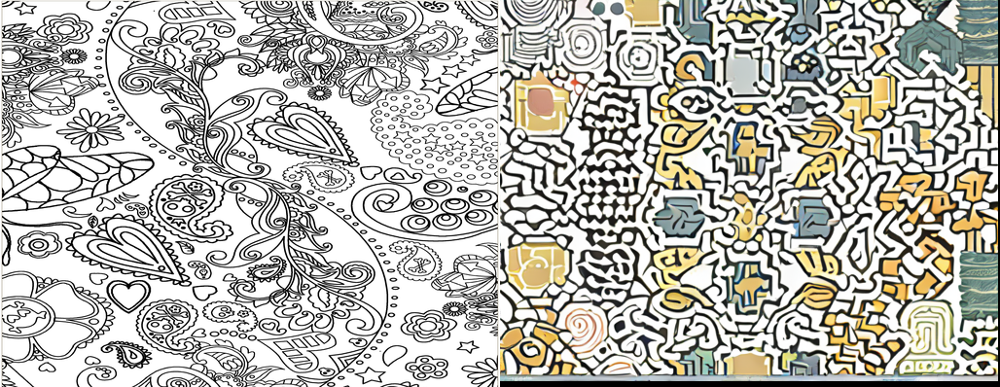

In [25]:
image_path = "/kaggle/input/images/80403031-PP.jpg"

image = Image.open(image_path)

# Specify the new size. For example, to resize to half the original width and height
new_size = (image.width // 6, image.height // 10)

# Resize the image
init_image = image.resize(new_size, Image.ANTIALIAS)

prompt = "Create a new variation of the provided design pattern, capturing the original's artistic style and color scheme. Adapt the design to include new, yet harmonious color combinations, ensuring variant respects the initial pattern's essence and artistic flair. Aim for diversity while maintaining a cohesive link to the original concept."

image = pipeline_image2image(prompt, image=init_image,strength=0.6, guidance_scale=0.0, num_inference_steps=50).images[0]
make_image_grid([init_image, image], rows=1, cols=2)

/tmp/ipykernel_25/2376787324.py:9: DeprecationWarning: ANTIALIAS is deprecated and will be removed in Pillow 10 (2023-07-01). Use LANCZOS or Resampling.LANCZOS instead.
  init_image = image.resize(new_size, Image.ANTIALIAS)


  0%|          | 0/33 [00:00<?, ?it/s]

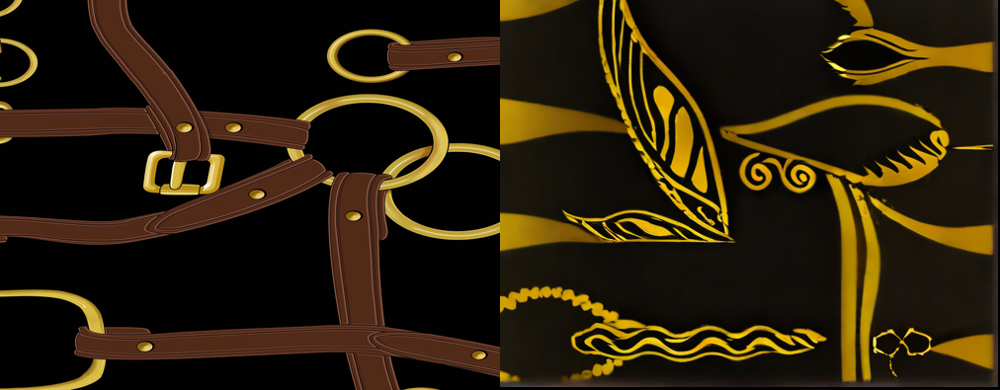

In [26]:
image_path = "/kaggle/input/images/PRINT PAGE-CU8710.jpg"

image = Image.open(image_path)

# Specify the new size. For example, to resize to half the original width and height
new_size = (image.width // 6, image.height // 10)

# Resize the image
init_image = image.resize(new_size, Image.ANTIALIAS)

prompt = "Create a new variation of the provided design pattern,capturing the original's artistic style and color scheme. Adapt the design to include new, yet harmonious color combinations, ensuring variant respects the initial pattern's essence and artistic flair. Aim for diversity while maintaining a cohesive link to the original concept."
negative_prompt = """ugly, deformed, disfigured, poor details Do not create plain or monochromatic patterns, avoid clashing colors and simplistic or modern styles that do not match the intricate."""
image = pipeline_image2image(prompt, image=init_image,negative_prompt=negative_prompt,strength=0.66,guidance_scale=0.3).images[0]
make_image_grid([init_image, image], rows=1, cols=2)

/tmp/ipykernel_25/1668712701.py:9: DeprecationWarning: ANTIALIAS is deprecated and will be removed in Pillow 10 (2023-07-01). Use LANCZOS or Resampling.LANCZOS instead.
  init_image = image.resize(new_size, Image.ANTIALIAS)


  0%|          | 0/15 [00:00<?, ?it/s]

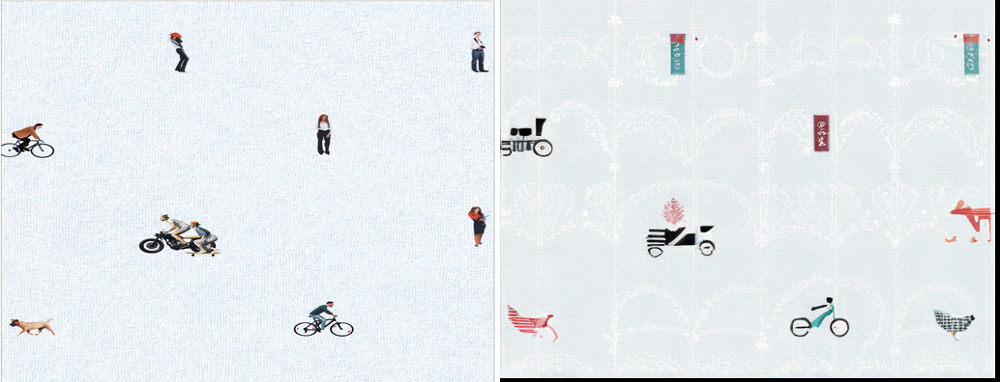

In [27]:
image_path = "/kaggle/input/images/PRINT PAGE-NC2406.jpg"

image = Image.open(image_path)

# Specify the new size. For example, to resize to half the original width and height
new_size = (image.width // 6, image.height // 10)

# Resize the image
init_image = image.resize(new_size, Image.ANTIALIAS)

prompt = "Create a new variation of the provided design pattern, capturing the original's artistic style and color scheme. Adapt the design to include new, yet harmonious color combinations, ensuring variant respects the initial pattern's essence and artistic flair. Aim for diversity while maintaining a cohesive link to the original concept."
negative_prompt = """ugly, deformed, disfigured, poor details"""
image = pipeline_image2image(prompt,negative_prompt=negative_prompt, image=init_image,strength=0.3).images[0]
make_image_grid([init_image, image], rows=1, cols=2)

# Kandinsky

### Kandinsky 2.1

In [28]:
import torch
from diffusers import KandinskyImg2ImgPipeline, KandinskyPriorPipeline

prior_pipeline = KandinskyPriorPipeline.from_pretrained("kandinsky-community/kandinsky-2-1-prior", torch_dtype=torch.float16, use_safetensors=True).to("cuda")
pipeline = KandinskyImg2ImgPipeline.from_pretrained("kandinsky-community/kandinsky-2-1", torch_dtype=torch.float16, use_safetensors=True).to("cuda")

model_index.json:   0%|          | 0.00/500 [00:00<?, ?B/s]

Fetching 13 files:   0%|          | 0/13 [00:00<?, ?it/s]

scheduler/scheduler_config.json:   0%|          | 0.00/229 [00:00<?, ?B/s]

image_processor/preprocessor_config.json:   0%|          | 0.00/315 [00:00<?, ?B/s]

text_encoder/config.json:   0%|          | 0.00/626 [00:00<?, ?B/s]

image_encoder/config.json:   0%|          | 0.00/574 [00:00<?, ?B/s]

prior/config.json:   0%|          | 0.00/252 [00:00<?, ?B/s]

tokenizer/special_tokens_map.json:   0%|          | 0.00/460 [00:00<?, ?B/s]

tokenizer/merges.txt:   0%|          | 0.00/525k [00:00<?, ?B/s]

tokenizer/tokenizer_config.json:   0%|          | 0.00/767 [00:00<?, ?B/s]

tokenizer/vocab.json:   0%|          | 0.00/1.06M [00:00<?, ?B/s]

image_encoder/model.safetensors:   0%|          | 0.00/1.22G [00:00<?, ?B/s]

text_encoder/model.safetensors:   0%|          | 0.00/495M [00:00<?, ?B/s]

(…)rior/diffusion_pytorch_model.safetensors:   0%|          | 0.00/4.09G [00:00<?, ?B/s]

Loading pipeline components...:   0%|          | 0/6 [00:00<?, ?it/s]

model_index.json:   0%|          | 0.00/385 [00:00<?, ?B/s]

Fetching 12 files:   0%|          | 0/12 [00:00<?, ?it/s]

movq/config.json:   0%|          | 0.00/660 [00:00<?, ?B/s]

tokenizer/special_tokens_map.json:   0%|          | 0.00/280 [00:00<?, ?B/s]

text_encoder/config.json:   0%|          | 0.00/662 [00:00<?, ?B/s]

scheduler/scheduler_config.json:   0%|          | 0.00/318 [00:00<?, ?B/s]

tokenizer/tokenizer.json:   0%|          | 0.00/17.1M [00:00<?, ?B/s]

tokenizer/tokenizer_config.json:   0%|          | 0.00/418 [00:00<?, ?B/s]

unet/config.json:   0%|          | 0.00/1.68k [00:00<?, ?B/s]

movq/diffusion_pytorch_model.safetensors:   0%|          | 0.00/271M [00:00<?, ?B/s]

text_encoder/model.safetensors:   0%|          | 0.00/2.24G [00:00<?, ?B/s]

tokenizer/sentencepiece.bpe.model:   0%|          | 0.00/5.07M [00:00<?, ?B/s]

unet/diffusion_pytorch_model.safetensors:   0%|          | 0.00/4.91G [00:00<?, ?B/s]

Loading pipeline components...:   0%|          | 0/5 [00:00<?, ?it/s]

You are using a model of type xlm-roberta to instantiate a model of type M-CLIP. This is not supported for all configurations of models and can yield errors.


In [29]:
from PIL import Image
import io

image_path = "/kaggle/input/images/281.jpg"

image = Image.open(image_path)

# Specify the new size. For example, to resize to half the original width and height
new_size = (image.width // 6, image.height // 10)

# Resize the image
init_image = image.resize(new_size, Image.ANTIALIAS)

prompt = "Create a new variation of the provided design pattern, capturing the original's artistic style and color scheme. Adapt the design to include new, yet harmonious color combinations, ensuring variant respects the initial pattern's essence and artistic flair. Aim for diversity while maintaining a cohesive link to the original concept."
negative_prompt = """ugly, deformed, disfigured, poor details,low quality, bad quality"""

image_embeds, negative_image_embeds = prior_pipeline(prompt, negative_prompt).to_tuple()

/tmp/ipykernel_25/269932770.py:12: DeprecationWarning: ANTIALIAS is deprecated and will be removed in Pillow 10 (2023-07-01). Use LANCZOS or Resampling.LANCZOS instead.
  init_image = image.resize(new_size, Image.ANTIALIAS)


  0%|          | 0/25 [00:00<?, ?it/s]

  0%|          | 0/30 [00:00<?, ?it/s]

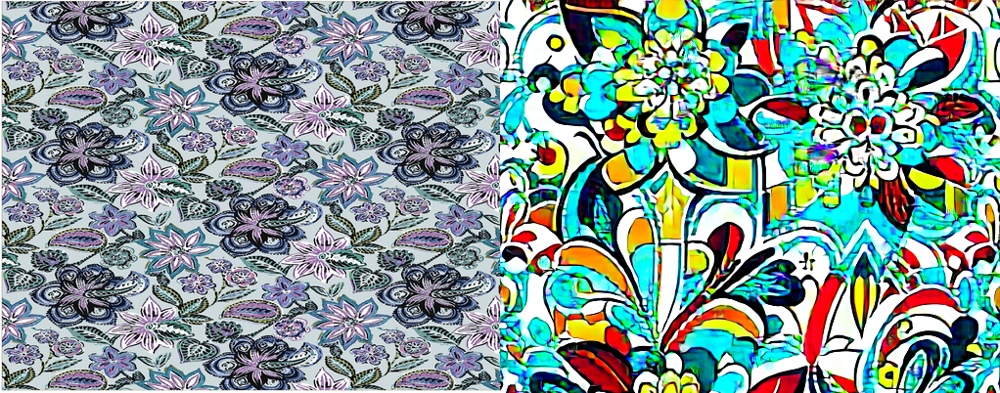

In [30]:
from diffusers.utils import make_image_grid

image = pipeline(prompt, negative_prompt=negative_prompt, image=init_image, image_embeds=image_embeds, negative_image_embeds=negative_image_embeds,strength=0.3).images[0]
make_image_grid([init_image, image], rows=1, cols=2)

In [31]:
from PIL import Image
import io

image_path = "/kaggle/input/images/80403031-PP.jpg"

image = Image.open(image_path)

# Specify the new size. For example, to resize to half the original width and height
new_size = (image.width // 6, image.height // 10)

# Resize the image
init_image = image.resize(new_size, Image.ANTIALIAS)

prompt = "Create a new variation of the provided design pattern, capturing the original's artistic style and color scheme. Adapt the design to include new, yet harmonious color combinations, ensuring variant respects the initial pattern's essence and artistic flair. Aim for diversity while maintaining a cohesive link to the original concept."
negative_prompt = """ugly, deformed, disfigured, poor details,low quality, bad quality"""

image_embeds, negative_image_embeds = prior_pipeline(prompt, negative_prompt).to_tuple()

/tmp/ipykernel_25/945657947.py:12: DeprecationWarning: ANTIALIAS is deprecated and will be removed in Pillow 10 (2023-07-01). Use LANCZOS or Resampling.LANCZOS instead.
  init_image = image.resize(new_size, Image.ANTIALIAS)


  0%|          | 0/25 [00:00<?, ?it/s]

  0%|          | 0/35 [00:00<?, ?it/s]

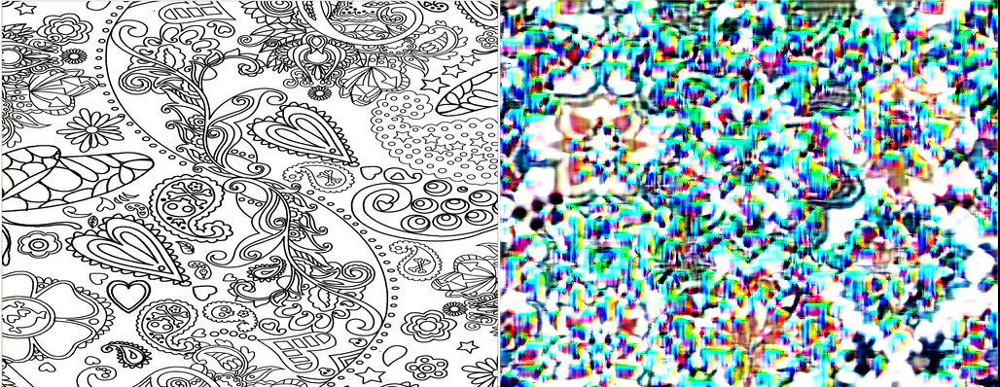

In [32]:
image = pipeline(prompt, negative_prompt=negative_prompt, image=init_image, image_embeds=image_embeds, negative_image_embeds=negative_image_embeds,strength=0.35).images[0]
make_image_grid([init_image, image], rows=1, cols=2)

In [33]:
from PIL import Image
import io

image_path = "/kaggle/input/images/PRINT PAGE-CU8710.jpg"

image = Image.open(image_path)

# Specify the new size. For example, to resize to half the original width and height
new_size = (image.width // 6, image.height // 10)

# Resize the image
init_image = image.resize(new_size, Image.ANTIALIAS)

prompt = "Create a new variation of the provided design pattern, capturing the original's artistic style and color scheme. Adapt the design to include new, yet harmonious color combinations, ensuring variant respects the initial pattern's essence and artistic flair. Aim for diversity while maintaining a cohesive link to the original concept."
negative_prompt = """ugly, deformed, disfigured, poor details,low quality, bad quality"""

image_embeds, negative_image_embeds = prior_pipeline(prompt, negative_prompt).to_tuple()

/tmp/ipykernel_25/3438830577.py:12: DeprecationWarning: ANTIALIAS is deprecated and will be removed in Pillow 10 (2023-07-01). Use LANCZOS or Resampling.LANCZOS instead.
  init_image = image.resize(new_size, Image.ANTIALIAS)


  0%|          | 0/25 [00:00<?, ?it/s]

  0%|          | 0/30 [00:00<?, ?it/s]

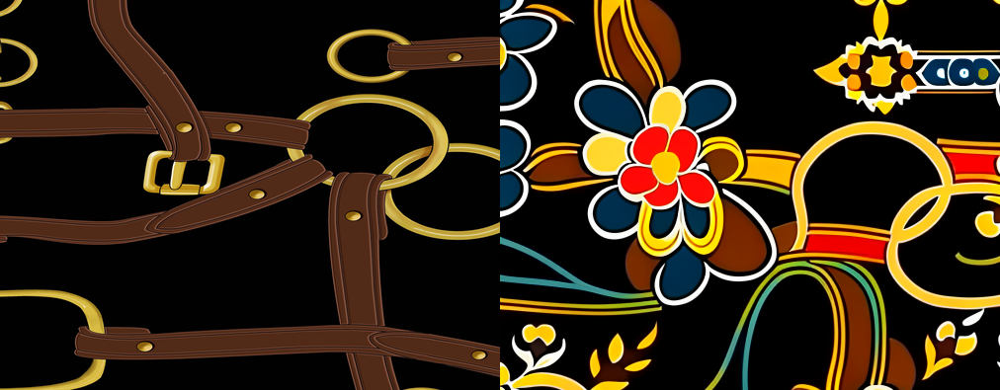

In [34]:
from diffusers.utils import load_image, make_image_grid
image = pipeline(prompt, negative_prompt=negative_prompt, image=init_image, image_embeds=image_embeds, negative_image_embeds=negative_image_embeds,strength=0.3).images[0]
make_image_grid([init_image, image], rows=1, cols=2)

In [35]:
from PIL import Image
import io

image_path = "/kaggle/input/images/PRINT PAGE-NC2406.jpg"

image = Image.open(image_path)

# Specify the new size. For example, to resize to half the original width and height
new_size = (image.width // 6, image.height // 10)

# Resize the image
init_image = image.resize(new_size, Image.ANTIALIAS)

prompt = "Create a new variation of the provided design pattern, capturing the original's artistic style and color scheme. Adapt the design to include new, yet harmonious color combinations, ensuring variant respects the initial pattern's essence and artistic flair. Aim for diversity while maintaining a cohesive link to the original concept."
negative_prompt = """ugly, deformed, disfigured, poor details,low quality, bad quality"""

image_embeds, negative_image_embeds = prior_pipeline(prompt, negative_prompt).to_tuple()

/tmp/ipykernel_25/3253825560.py:12: DeprecationWarning: ANTIALIAS is deprecated and will be removed in Pillow 10 (2023-07-01). Use LANCZOS or Resampling.LANCZOS instead.
  init_image = image.resize(new_size, Image.ANTIALIAS)


  0%|          | 0/25 [00:00<?, ?it/s]

  0%|          | 0/15 [00:00<?, ?it/s]

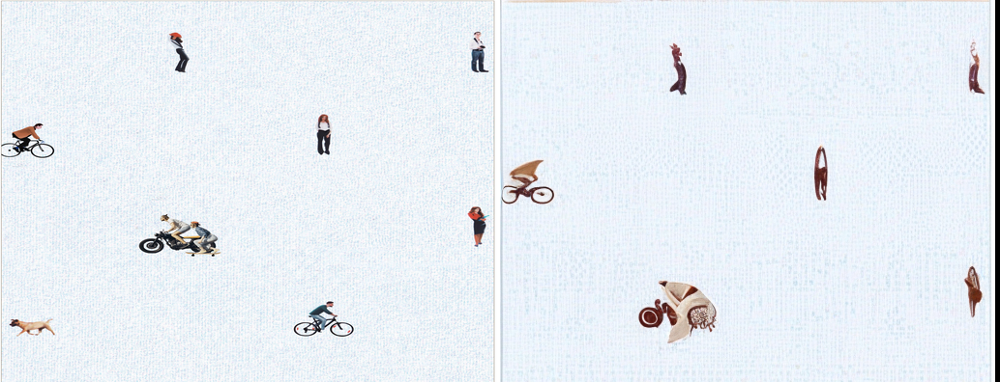

In [36]:
from diffusers.utils import load_image, make_image_grid
image = pipeline(prompt, negative_prompt=negative_prompt, image=init_image, image_embeds=image_embeds, negative_image_embeds=negative_image_embeds,strength=0.15,guidance_scale=1).images[0]
make_image_grid([init_image, image], rows=1, cols=2)

### Kandinsky 2.2

In [37]:
import torch
from diffusers import KandinskyV22Img2ImgPipeline, KandinskyPriorPipeline

prior_pipeline = KandinskyPriorPipeline.from_pretrained("kandinsky-community/kandinsky-2-2-prior", torch_dtype=torch.float16, use_safetensors=True).to("cuda")
pipeline = KandinskyV22Img2ImgPipeline.from_pretrained("kandinsky-community/kandinsky-2-2-decoder", torch_dtype=torch.float16, use_safetensors=True).to("cuda")

Loading pipeline components...:   0%|          | 0/6 [00:00<?, ?it/s]

OutOfMemoryError: CUDA out of memory. Tried to allocate 20.00 MiB. GPU 0 has a total capacty of 15.89 GiB of which 38.12 MiB is free. Process 2444 has 15.86 GiB memory in use. Of the allocated memory 15.20 GiB is allocated by PyTorch, and 364.06 MiB is reserved by PyTorch but unallocated. If reserved but unallocated memory is large try setting max_split_size_mb to avoid fragmentation.  See documentation for Memory Management and PYTORCH_CUDA_ALLOC_CONF

In [ ]:
from PIL import Image
import io

image_path = "/kaggle/input/images/PRINT PAGE-CU8439.jpg"

image = Image.open(image_path)

# Specify the new size. For example, to resize to half the original width and height
new_size = (image.width // 6, image.height // 10)

# Resize the image
init_image = image.resize(new_size, Image.ANTIALIAS)

prompt = "Create a new variation of the provided design pattern, capturing the original's artistic style and color scheme. Adapt the design to include new, yet harmonious color combinations, ensuring variant respects the initial pattern's essence and artistic flair. Aim for diversity while maintaining a cohesive link to the original concept."
negative_prompt = """ugly, deformed, disfigured, poor details,low quality, bad quality"""

image_embeds, negative_image_embeds = prior_pipeline(prompt, negative_prompt).to_tuple()

In [ ]:
from diffusers.utils import make_image_grid

image = pipeline(image=init_image, image_embeds=image_embeds, negative_image_embeds=negative_image_embeds,strength=0.15).images[0]
make_image_grid([init_image, image], rows=1, cols=2)

In [ ]:
from PIL import Image
import io

image_path = "/kaggle/input/images/281.jpg"

image = Image.open(image_path)

# Specify the new size. For example, to resize to half the original width and height
new_size = (image.width // 6, image.height // 10)

# Resize the image
init_image = image.resize(new_size, Image.ANTIALIAS)

prompt = "Create a new variation of the provided design pattern, capturing the original's artistic style and color scheme. Adapt the design to include new, yet harmonious color combinations, ensuring variant respects the initial pattern's essence and artistic flair. Aim for diversity while maintaining a cohesive link to the original concept."
negative_prompt = """ugly, deformed, disfigured, poor details,low quality, bad quality"""

image_embeds, negative_image_embeds = prior_pipeline(prompt, negative_prompt).to_tuple()

In [ ]:
from diffusers.utils import make_image_grid

image = pipeline(image=init_image, image_embeds=image_embeds, negative_image_embeds=negative_image_embeds,strength=0.1).images[0]
make_image_grid([init_image, image], rows=1, cols=2)

In [ ]:
image_path = "/kaggle/input/images/80403031-PP.jpg"

image = Image.open(image_path)

# Specify the new size. For example, to resize to half the original width and height
new_size = (image.width // 6, image.height // 10)

# Resize the image
init_image = image.resize(new_size, Image.ANTIALIAS)

prompt = "Create a new variation of the provided design pattern, capturing the original's artistic style and color scheme. Adapt the design to include new, yet harmonious color combinations, ensuring variant respects the initial pattern's essence and artistic flair. Aim for diversity while maintaining a cohesive link to the original concept."
negative_prompt = """ugly, deformed, disfigured, poor details,low quality, bad quality"""

image_embeds, negative_image_embeds = prior_pipeline(prompt, negative_prompt).to_tuple()

In [ ]:
from diffusers.utils import make_image_grid

image = pipeline(image=init_image, image_embeds=image_embeds, negative_image_embeds=negative_image_embeds,strength=0.4, guidance_scale=0.6).images[0]
make_image_grid([init_image, image], rows=1, cols=2)

In [ ]:
from PIL import Image
import io

image_path = "/kaggle/input/images/PRINT PAGE-CU8710.jpg"

image = Image.open(image_path)

# Specify the new size. For example, to resize to half the original width and height
new_size = (image.width // 6, image.height // 10)

# Resize the image
init_image = image.resize(new_size, Image.ANTIALIAS)

prompt = "Create a new variation of the provided design pattern, capturing the original's artistic style and color scheme. Adapt the design to include new, yet harmonious color combinations, ensuring variant respects the initial pattern's essence and artistic flair. Aim for diversity while maintaining a cohesive link to the original concept."
negative_prompt = """ugly, deformed, disfigured, poor details,low quality, bad quality"""

image_embeds, negative_image_embeds = prior_pipeline(prompt, negative_prompt).to_tuple()

In [ ]:
from diffusers.utils import make_image_grid

image = pipeline(image=init_image, image_embeds=image_embeds, negative_image_embeds=negative_image_embeds,strength=0.5, guidance_scale=0.2).images[0]
make_image_grid([init_image, image], rows=1, cols=2)

In [ ]:
from PIL import Image
import io

image_path = "/kaggle/input/images/PRINT PAGE-NC2406.jpg"

image = Image.open(image_path)

# Specify the new size. For example, to resize to half the original width and height
new_size = (image.width // 6, image.height // 10)

# Resize the image
init_image = image.resize(new_size, Image.ANTIALIAS)

prompt = "Create a new variation of the provided design pattern, capturing the original's artistic style and color scheme. Adapt the design to include new, yet harmonious color combinations, ensuring variant respects the initial pattern's essence and artistic flair. Aim for diversity while maintaining a cohesive link to the original concept."
negative_prompt = """ugly, deformed, disfigured, poor details,low quality, bad quality"""

image_embeds, negative_image_embeds = prior_pipeline(prompt, negative_prompt).to_tuple()

In [ ]:
image = pipeline(image=init_image, image_embeds=image_embeds, negative_image_embeds=negative_image_embeds,strength=0.16).images[0]
make_image_grid([init_image, image], rows=1, cols=2)

In [ ]:
import torch
from diffusers import AutoPipelineForImage2Image
from diffusers.utils import make_image_grid, load_image

In [ ]:
pipeline = AutoPipelineForImage2Image.from_pretrained(
    "runwayml/stable-diffusion-v1-5", torch_dtype=torch.float16, variant="fp16", use_safetensors=True
)
pipeline.enable_model_cpu_offload()

In [ ]:
from PIL import Image
import io

image_path = "/kaggle/input/images/PRINT PAGE-CU8439.jpg"# Update this path

image = Image.open(image_path)

# Specify the new size. For example, to resize to half the original width and height
new_size = (image.width // 6, image.height // 10)

# Resize the image
init_image = image.resize(new_size, Image.ANTIALIAS)


# Now, compressed_image is the version with reduced file size and quality
# You can proceed to pass this image to the pipeline
prompt = "Create variations of the provided shirt design pattern, capturing the original's artistic style and color scheme. Adapt the design to include new, yet harmonious color combinations, ensuring variant respects the initial pattern's essence and artistic flair. Aim for diversity while maintaining a cohesive link to the original concept."
negative_prompt = """ugly, deformed, disfigured, poor details, bad anatomy Do not create plain or monochromatic patterns, avoid clashing colors and simplistic or modern styles that do not match the intricate, traditional, and floral essence of the original artwork."""
# Assuming your pipeline setup is done earlier and here's how you pass the compressed image to it
result_image = pipeline(prompt, negative_prompt=negative_prompt,image=init_image,num_inference_steps=200,strength=0.5).images[0]
make_image_grid([init_image, result_image], rows=1, cols=2)

In [ ]:
import torch
from diffusers import AutoPipelineForImage2Image
from diffusers.utils import make_image_grid, load_image

pipeline = AutoPipelineForImage2Image.from_pretrained(
    "kandinsky-community/kandinsky-2-2-decoder", torch_dtype=torch.float16, use_safetensors=True
)
pipeline.enable_model_cpu_offload()

In [ ]:
from PIL import Image
import io



image_path = r"/kaggle/input/images/PRINT PAGE-CU8439.jpg"# Update this path

image = Image.open(image_path)

# Specify the new size. For example, to resize to half the original width and height
new_size = (image.width // 6, image.height // 10)

# Resize the image
init_image = image.resize(new_size, Image.ANTIALIAS)

prompt = '''Create variations of the provided design pattern, capturing the original's artistic style and color scheme. Adapt the design to include new, yet harmonious color combinations, ensuring variant respects the initial pattern's essence and artistic flair.
Aim for diversity while maintaining a cohesive link to the original concept.output image should look like Input image'''

# pass prompt and image to pipeline
image = pipeline(prompt, image=init_image).images[0]
make_image_grid([init_image, image], rows=1, cols=2)

In [ ]:
from PIL import Image
import io



image_path = r"/kaggle/input/images/281.jpg"# Update this path

image = Image.open(image_path)

# Specify the new size. For example, to resize to half the original width and height
new_size = (image.width // 6, image.height // 10)

# Resize the image
init_image = image.resize(new_size, Image.ANTIALIAS)

prompt = '''Create variation of the provided design pattern, capturing the original's artistic style and color scheme. Adapt the design to include new, yet harmonious color combinations, ensuring variant respects the initial pattern's essence and artistic flair.
Aim for diversity while maintaining a cohesive link to the original concept.output image should look like Input image'''

# pass prompt and image to pipeline
image = pipeline(prompt, image=init_image).images[0]
make_image_grid([init_image, image], rows=1, cols=2)

In [ ]:
from PIL import Image
import io



image_path = r"/kaggle/input/images/PRINT PAGE-CU8439.jpg"# Update this path

image = Image.open(image_path)

# Specify the new size. For example, to resize to half the original width and height
new_size = (image.width // 6, image.height // 10)

# Resize the image
init_image = image.resize(new_size, Image.ANTIALIAS)

prompt = '''Create a single variation of the provided design pattern, maintaining the original's artistic style and color scheme. The adaptation should introduce new, harmonious color combinations that respect the essence and artistic flair of the initial pattern. The goal is to diversify while ensuring a cohesive link to the original concept. The output image should focus on one distinct variation.'''
negative_prompt = """ugly, deformed, disfigured, poor details, bad anatomy Do not create plain or monochromatic patterns, avoid clashing colors and simplistic or modern styles that do not match the intricate, traditional, and floral essence of the original artwork."""

# pass prompt and image to pipeline
image = pipeline(prompt, image=init_image).images[0]
make_image_grid([init_image, image], rows=1, cols=2)

In [ ]:
from PIL import Image
import io

image_path = r"/kaggle/input/images/PRINT PAGE-CU8439.jpg"# Update this path

image = Image.open(image_path)

# Specify the new size. For example, to resize to half the original width and height
new_size = (image.width // 6, image.height // 10)

# Resize the image
init_image = image.resize(new_size, Image.ANTIALIAS)

prompt = '''Create a single variation of the provided design pattern, maintaining the original's artistic style and color scheme. The adaptation should introduce new, harmonious color combinations that respect the essence and artistic flair of the initial pattern. The goal is to diversify while ensuring a cohesive link to the original concept. The output image should focus on one distinct variation.'''

# pass prompt and image to pipeline
image = pipeline(prompt, image=init_image).images[0]
make_image_grid([init_image, image], rows=1, cols=2)

In [ ]:
from diffusers import ControlNetModel, AutoPipelineForImage2Image
import torch

controlnet = ControlNetModel.from_pretrained("lllyasviel/control_v11f1p_sd15_depth", torch_dtype=torch.float16, variant="fp16", use_safetensors=True)
pipeline = AutoPipelineForImage2Image.from_pretrained(
    "runwayml/stable-diffusion-v1-5", controlnet=controlnet, torch_dtype=torch.float16, variant="fp16", use_safetensors=True
)
pipeline.enable_model_cpu_offload()

In [ ]:
from diffusers.utils import load_image, make_image_grid

image_path = r"/kaggle/input/images/PRINT PAGE-CU8439.jpg"# Update this path

image = Image.open(image_path)

# Specify the new size. For example, to resize to half the original width and height
new_size = (image.width // 6, image.height // 10)

# Resize the image
init_image = image.resize(new_size, Image.ANTIALIAS)
depth_image = load_image("https://huggingface.co/lllyasviel/control_v11f1p_sd15_depth/resolve/main/images/control.png")
make_image_grid([init_image, depth_image], rows=1, cols=2)

In [ ]:
from PIL import Image
import io

image_path = r"/kaggle/input/images/PRINT PAGE-CU8439.jpg"# Update this path

image = Image.open(image_path)

# Specify the new size. For example, to resize to half the original width and height
new_size = (image.width // 6, image.height // 10)

# Resize the image
init_image = image.resize(new_size, Image.ANTIALIAS)



prompt = '''Create a single variation of the provided design pattern, maintaining the original's artistic style and color scheme. The adaptation should introduce new, harmonious color combinations that respect the essence and artistic flair of the initial pattern. The goal is to diversify while ensuring a cohesive link to the original concept. The output image should focus on one distinct variation.'''

image_control_net = pipeline(prompt, image=init_image, control_image=depth_image).images[0]
make_image_grid([init_image, depth_image, image_control_net], rows=1, cols=3)

In [ ]:
import torch
from diffusers import AutoPipelineForImage2Image
from diffusers.utils import make_image_grid, load_image

pipeline = AutoPipelineForImage2Image.from_pretrained(
    "stabilityai/stable-diffusion-xl-refiner-1.0", torch_dtype=torch.float16, variant="fp16", use_safetensors=True
)
pipeline.enable_model_cpu_offload()


In [ ]:
from PIL import Image
import io

image_path = r"/kaggle/input/images/PRINT PAGE-CU8439.jpg"# Update this path

image = Image.open(image_path)

# Specify the new size. For example, to resize to half the original width and height
new_size = (image.width // 6, image.height // 10)

# Resize the image
init_image = image.resize(new_size, Image.ANTIALIAS)

prompt = '''Create a single variation of the provided design pattern, maintaining the original's artistic style and color scheme. The adaptation should introduce new, harmonious color combinations that respect the essence and artistic flair of the initial pattern. The goal is to diversify while ensuring a cohesive link to the original concept. The output image should focus on one distinct variation.'''

negative_prompt = "ugly, deformed, disfigured, poor details, bad anatomy"

# pass prompt and image to pipeline
image = pipeline(prompt, negative_prompt=negative_prompt, image=init_image).images[0]
make_image_grid([init_image, image], rows=1, cols=2)

In [ ]:
from PIL import Image
import io

image_path = r"/kaggle/input/images/PRINT PAGE-NC2406.jpg"# Update this path

image = Image.open(image_path)

# Specify the new size. For example, to resize to half the original width and height
new_size = (image.width // 6, image.height // 10)

# Resize the image
init_image = image.resize(new_size, Image.ANTIALIAS)

prompt = '''Create a single variation of the provided design pattern, maintaining the original's artistic style and color scheme. The adaptation should introduce new, harmonious color combinations that respect the essence and artistic flair of the initial pattern. The goal is to diversify while ensuring a cohesive link to the original concept. The output image should focus on one distinct variation.'''

# negative_prompt = "ugly, deformed, disfigured, poor details, bad anatomy"

# pass prompt and image to pipeline
image = pipeline(prompt, image=init_image).images[0]
make_image_grid([init_image, image], rows=1, cols=2)

In [ ]:
from diffusers import StableDiffusionLatentUpscalePipeline

upscaler = StableDiffusionLatentUpscalePipeline.from_pretrained(
    "stabilityai/sd-x2-latent-upscaler", torch_dtype=torch.float16, use_safetensors=True
)
upscaler.enable_model_cpu_offload()

In [ ]:
# image_2 = upscaler(prompt, image=image, output_type="latent").images[0]

In [ ]:
from diffusers import StableDiffusionUpscalePipeline

super_res = StableDiffusionUpscalePipeline.from_pretrained(
    "stabilityai/stable-diffusion-x4-upscaler", torch_dtype=torch.float16, variant="fp16", use_safetensors=True
)
super_res.enable_model_cpu_offload()

In [ ]:
image_3 = super_res(prompt, image=image).images[0]
make_image_grid([init_image, image_3.resize((512, 512))], rows=1, cols=2)